   # IMAGE COMPRESSION USING SVD
   
   
   
   
   
   
   
   - NLA
   - presenter: Evans Musonda

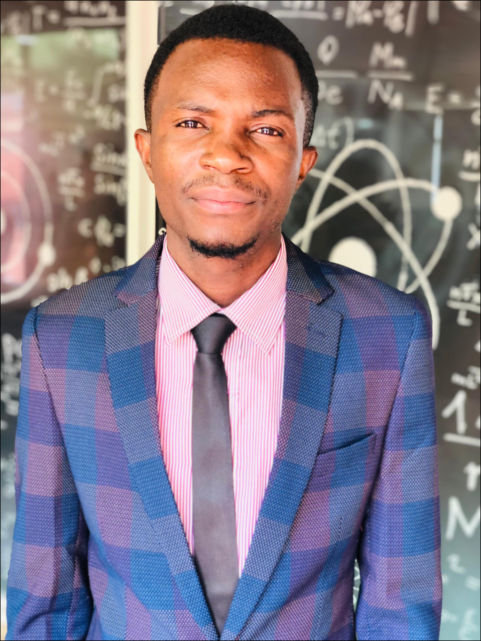

In [2]:
using Images, ImageIO, LinearAlgebra, ImageMagick

# Step o: Read the image
image_path = "evans.jpeg"
image_matrix = load(image_path)
display(image_matrix)  # Display the original image

In [3]:
dim= size(image_matrix)

(2560, 1920)

In [4]:
println(image_matrix)

RGB{N0f8}[RGB{N0f8}(0.282,0.231,0.196) RGB{N0f8}(0.282,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.302,0.224,0.196) RGB{N0f8}(0.302,0.224,0.196) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.29,0.2

) RGB{N0f8}(0.373,0.298,0.243) RGB{N0f8}(0.361,0.286,0.231) RGB{N0f8}(0.341,0.267,0.212) RGB{N0f8}(0.325,0.251,0.196) RGB{N0f8}(0.306,0.227,0.184) RGB{N0f8}(0.294,0.216,0.173) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.275,0.196,0.153) RGB{N0f8}(0.267,0.188,0.145) RGB{N0f8}(0.278,0.2,0.157) RGB{N0f8}(0.278,0.2,0.157) RGB{N0f8}(0.278,0.2,0.157) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.29,0.212,0.169) RGB{N0f8}(0.302,0.224,0.18) RGB{N0f8}(0.314,0.235,0.192) RGB{N0f8}(0.325,0.247,0.204) RGB{N0f8}(0.333,0.255,0.212) RGB{N0f8}(0.345,0.26

 RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.49,0.475,0.431) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.502,0.486,0.443) RGB{N0f8}(0.51,0.494,0.451) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.518,0.502,0.459) RGB{N0f8}(0.522,0.506,0.463) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.494,0.471) RGB{N0f8}(0.514,0.494,0.471) RGB{N0f8}(0.514,0.494,0.471) RGB{N0f8}(0.51,0.49,0.467) RGB{N0f8}(0.51,0.49,0.467) RGB{N0f8}(0.506,0.486,0.463) RGB{N0f8}(0.506,0.486,0.463) RGB{N0f8}(0.506,0.486,0.463) RGB{N0f8}(0.502,0.482,0.459) RGB{N0f8}(0.502,0.482,0.459) RGB{N0f8}(0.502,0.482,0.459) RGB{N0f8}(0.502,0.482,0.459) RGB{N0f8}(0.502,0.482,0.459) RGB{N0f8}(0.502,0.4

0.843,0.8) RGB{N0f8}(0.863,0.847,0.804) RGB{N0f8}(0.863,0.847,0.804) RGB{N0f8}(0.863,0.847,0.804) RGB{N0f8}(0.859,0.843,0.8) RGB{N0f8}(0.859,0.843,0.8) RGB{N0f8}(0.855,0.839,0.796) RGB{N0f8}(0.851,0.835,0.792) RGB{N0f8}(0.839,0.824,0.78) RGB{N0f8}(0.827,0.812,0.769) RGB{N0f8}(0.816,0.8,0.757) RGB{N0f8}(0.808,0.792,0.749) RGB{N0f8}(0.796,0.776,0.753) RGB{N0f8}(0.784,0.765,0.741) RGB{N0f8}(0.769,0.749,0.725) RGB{N0f8}(0.753,0.733,0.71) RGB{N0f8}(0.745,0.725,0.702) RGB{N0f8}(0.737,0.718,0.694) RGB{N0f8}(0.725,0.706,0.682) RGB{N0f8}(0.714,0.694,0.671) RGB{N0f8}(0.714,0.694,0.671) RGB{N0f8}(0.714,0.694,0.671) RGB{N0f8}(0.71,0.69,0.667) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.733,0.698,0.678) RGB{N0f8}(0.741,0.706,0.686) RGB{N0f8}(0.749,0.714,0.694) RGB{N0f8}(0.757,0.722,0.702) RGB{N0f8}(0.761,0.725,0.706) RGB{N0f8}(0.769,0.733,0.714) RGB{N0f8}(0.784,0.749,0.729) RGB{N0f8}(0.7

N0f8}(0.533,0.463,0.416) RGB{N0f8}(0.533,0.463,0.416) RGB{N0f8}(0.537,0.467,0.42) RGB{N0f8}(0.537,0.467,0.42) RGB{N0f8}(0.533,0.463,0.416) RGB{N0f8}(0.533,0.463,0.416) RGB{N0f8}(0.525,0.455,0.4) RGB{N0f8}(0.522,0.451,0.396) RGB{N0f8}(0.522,0.451,0.396) RGB{N0f8}(0.518,0.447,0.392) RGB{N0f8}(0.514,0.443,0.388) RGB{N0f8}(0.51,0.439,0.384) RGB{N0f8}(0.51,0.439,0.384) RGB{N0f8}(0.51,0.439,0.384) RGB{N0f8}(0.49,0.42,0.365) RGB{N0f8}(0.494,0.424,0.369) RGB{N0f8}(0.498,0.427,0.373) RGB{N0f8}(0.49,0.42,0.365) RGB{N0f8}(0.486,0.416,0.361) RGB{N0f8}(0.486,0.416,0.361) RGB{N0f8}(0.49,0.42,0.365) RGB{N0f8}(0.498,0.427,0.373) RGB{N0f8}(0.533,0.463,0.408) RGB{N0f8}(0.541,0.471,0.416) RGB{N0f8}(0.553,0.482,0.427) RGB{N0f8}(0.569,0.498,0.443) RGB{N0f8}(0.584,0.514,0.459) RGB{N0f8}(0.596,0.525,0.471) RGB{N0f8}(0.608,0.537,0.482) RGB{N0f8}(0.616,0.545,0.49) RGB{N0f8}(0.631,0.561,0.506) RGB{N0f8}(0.631,0.561,0.506) RGB{N0f8}(0.639,0.569,0.514) RGB{N0f8}(0.647,0.576,0.522) RGB{N0f8}(0.655,0.584,0.529) RGB

 RGB{N0f8}(0.341,0.29,0.255) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.341,0.29,0.255) RGB{N0f8}(0.341,0.29,0.255) RGB{N0f8}(0.337,0.286,0.251) RGB{N0f8}(0.337,0.286,0.251) RGB{N0f8}(0.341,0.29,0.255) RGB{N0f8}(0.341,0.29,0.255) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.345,0.294,0.259); RGB{N0f8}(0.282,0.231,0.196) RGB{N0f8}(0.282,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.286,0.231,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.294,0.227,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.302,0.224,0.196) RGB{N0f8}(0.302,0.224,0.196) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.

,0.416) RGB{N0f8}(0.537,0.471,0.408) RGB{N0f8}(0.533,0.467,0.404) RGB{N0f8}(0.522,0.455,0.392) RGB{N0f8}(0.51,0.443,0.38) RGB{N0f8}(0.502,0.435,0.373) RGB{N0f8}(0.498,0.431,0.369) RGB{N0f8}(0.494,0.427,0.365) RGB{N0f8}(0.49,0.424,0.361) RGB{N0f8}(0.478,0.412,0.349) RGB{N0f8}(0.471,0.404,0.341) RGB{N0f8}(0.467,0.392,0.325) RGB{N0f8}(0.455,0.38,0.314) RGB{N0f8}(0.443,0.369,0.31) RGB{N0f8}(0.431,0.357,0.298) RGB{N0f8}(0.42,0.345,0.286) RGB{N0f8}(0.404,0.329,0.271) RGB{N0f8}(0.388,0.314,0.259) RGB{N0f8}(0.373,0.298,0.243) RGB{N0f8}(0.349,0.275,0.22) RGB{N0f8}(0.333,0.259,0.204) RGB{N0f8}(0.314,0.235,0.192) RGB{N0f8}(0.302,0.224,0.18) RGB{N0f8}(0.294,0.216,0.173) RGB{N0f8}(0.29,0.212,0.169) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.275,0.196,0.153) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.282,0.204,0.161) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.286,0.208,0.165) RGB{N0f8}(0.29,0.212,0.169) RGB{N0f8}(0.29,0.212,0.169) RGB{N0f8}(0.29,0.212,0.169) RGB{N0f8}(0.286,0.

0.482,0.435) RGB{N0f8}(0.494,0.478,0.431) RGB{N0f8}(0.494,0.478,0.431) RGB{N0f8}(0.49,0.475,0.427) RGB{N0f8}(0.49,0.475,0.427) RGB{N0f8}(0.49,0.475,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.486,0.471,0.427) RGB{N0f8}(0.49,0.475,0.431) RGB{N0f8}(0.49,0.475,0.431) RGB{N0f8}(0.49,0.475,0.431) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.494,0.478,0.435) RGB{N0f8}(0.498,0.482,0.439) RGB{N0f8}(0.502,0.486,0.443) RGB{N0f8}(0.51,0.494,0.451) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.518,0.502,0.459) RGB{N0f8}(0.518,0.502,0.459) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8}(0.514,0.498,0.455) RGB{N0f8

) RGB{N0f8}(0.831,0.824,0.773) RGB{N0f8}(0.82,0.812,0.753) RGB{N0f8}(0.804,0.796,0.745) RGB{N0f8}(0.792,0.784,0.733) RGB{N0f8}(0.784,0.776,0.725) RGB{N0f8}(0.773,0.765,0.714) RGB{N0f8}(0.757,0.749,0.702) RGB{N0f8}(0.745,0.737,0.69) RGB{N0f8}(0.722,0.714,0.667) RGB{N0f8}(0.71,0.702,0.655) RGB{N0f8}(0.694,0.682,0.647) RGB{N0f8}(0.682,0.671,0.635) RGB{N0f8}(0.667,0.655,0.62) RGB{N0f8}(0.647,0.635,0.6) RGB{N0f8}(0.624,0.612,0.576) RGB{N0f8}(0.604,0.592,0.565) RGB{N0f8}(0.596,0.576,0.561) RGB{N0f8}(0.588,0.569,0.557) RGB{N0f8}(0.573,0.553,0.541) RGB{N0f8}(0.561,0.541,0.529) RGB{N0f8}(0.549,0.529,0.518) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) 

,0.314) RGB{N0f8}(0.408,0.341,0.31) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.416,0.349,0.318) RGB{N0f8}(0.424,0.357,0.325) RGB{N0f8}(0.431,0.365,0.333) RGB{N0f8}(0.451,0.384,0.353) RGB{N0f8}(0.478,0.412,0.38) RGB{N0f8}(0.498,0.431,0.4) RGB{N0f8}(0.533,0.467,0.427) RGB{N0f8}(0.557,0.49,0.451) RGB{N0f8}(0.588,0.522,0.482) RGB{N0f8}(0.616,0.549,0.51) RGB{N0f8}(0.635,0.569,0.529) RGB{N0f8}(0.655,0.588,0.549) RGB{N0f8}(0.671,0.604,0.565) RGB{N0f8}(0.682,0.616,0.576) RGB{N0f8}(0.686,0.62,0.58) RGB{N0f8}(0.69,0.624,0.584) RGB{N0f8}(0.702,0.635,0.596) RGB{N0f8}(0.714,0.647,0.608) RGB{N0f8}(0.725,0.659,0.62) RGB{N0f8}(0.737,0.671,0.631) RGB{N0f8}(0.749,0.682,0.643) RGB{N0f8}(0.753,0.686,0.647) RGB{N0f8}(0.769,0.706,0.655) RGB{N0f8}(0.773,0.71,0.659) RGB{N0f8}(0.776,0.714,0.663) RGB{N0f8}(0.784,0.722,0.671) RGB{N0f8}(0.784,0.722,0.671) RGB{N0f8}(0.784,0.722,0.671) RGB{N0f8}(0.78,0.718,0.667) RGB{N0f8}(0.776,0.714,0.663) RGB{N0f8}(0.765,0.702,0.651) RGB{N0f8}(0.757,0.694,0.643) RGB{N0f8}(0.745,0.

0.573,0.514) RGB{N0f8}(0.631,0.569,0.51) RGB{N0f8}(0.631,0.569,0.51) RGB{N0f8}(0.627,0.565,0.514) RGB{N0f8}(0.62,0.553,0.514) RGB{N0f8}(0.612,0.545,0.514) RGB{N0f8}(0.596,0.529,0.498) RGB{N0f8}(0.584,0.518,0.486) RGB{N0f8}(0.573,0.506,0.475) RGB{N0f8}(0.553,0.486,0.455) RGB{N0f8}(0.529,0.463,0.431) RGB{N0f8}(0.514,0.447,0.416) RGB{N0f8}(0.482,0.416,0.384) RGB{N0f8}(0.463,0.396,0.365) RGB{N0f8}(0.435,0.369,0.337) RGB{N0f8}(0.408,0.341,0.31) RGB{N0f8}(0.388,0.322,0.29) RGB{N0f8}(0.369,0.302,0.271) RGB{N0f8}(0.349,0.282,0.251) RGB{N0f8}(0.337,0.271,0.239) RGB{N0f8}(0.318,0.251,0.224) RGB{N0f8}(0.31,0.243,0.216) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.306,0.239,0.212) RGB{N0f8}(0.306,0.239,0.212) RGB{N0f8}(0.306,0.239,0.212) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.302,0.235,0.208) RGB{N0f8}(0.306,0.239,0.212) RGB{N0f8}(0.306,0.239,0.212) RGB{N0f8}(0.31,0.243,0.216) RGB{N0f8}(0.31,0.243,0.216) RGB{N0f8}

,0.255,0.22) RGB{N0f8}(0.337,0.259,0.224) RGB{N0f8}(0.337,0.259,0.224) RGB{N0f8}(0.337,0.259,0.224) RGB{N0f8}(0.337,0.259,0.224) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.318,0.239,0.204) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.318,0.239,0.204) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.318,0.239,0.204) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0

,0.925,0.816) RGB{N0f8}(0.969,0.925,0.816) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.969,0.91,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.894,0.788) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.98,0.898,0.792) RGB{N0f8}(0.976,0.894,0.788) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.969,0.886,0.78) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.969,0.886,0.773) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.969,0.875,0.765) RGB{N0f8}(0.969,0.875,0.765) RGB{N0f8}(0.965,0.871,0.761) RGB{N0f8}(0.965,0.871,0.761) RGB{N0f8}

0.514) RGB{N0f8}(0.573,0.537,0.518) RGB{N0f8}(0.561,0.533,0.51) RGB{N0f8}(0.557,0.529,0.506) RGB{N0f8}(0.557,0.529,0.506) RGB{N0f8}(0.557,0.529,0.506) RGB{N0f8}(0.553,0.533,0.51) RGB{N0f8}(0.561,0.541,0.518) RGB{N0f8}(0.569,0.549,0.525) RGB{N0f8}(0.576,0.557,0.533) RGB{N0f8}(0.58,0.569,0.541) RGB{N0f8}(0.584,0.573,0.545) RGB{N0f8}(0.58,0.58,0.549) RGB{N0f8}(0.588,0.588,0.557) RGB{N0f8}(0.6,0.6,0.569) RGB{N0f8}(0.612,0.612,0.58) RGB{N0f8}(0.62,0.62,0.588) RGB{N0f8}(0.624,0.624,0.592) RGB{N0f8}(0.624,0.624,0.584) RGB{N0f8}(0.631,0.631,0.592) RGB{N0f8}(0.643,0.643,0.604) RGB{N0f8}(0.655,0.655,0.616) RGB{N0f8}(0.659,0.659,0.62) RGB{N0f8}(0.659,0.659,0.62) RGB{N0f8}(0.651,0.651,0.612) RGB{N0f8}(0.647,0.647,0.608) RGB{N0f8}(0.643,0.643,0.604) RGB{N0f8}(0.624,0.624,0.584) RGB{N0f8}(0.616,0.616,0.576) RGB{N0f8}(0.616,0.616,0.576) RGB{N0f8}(0.616,0.616,0.576) RGB{N0f8}(0.624,0.624,0.584) RGB{N0f8}(0.651,0.651,0.612) RGB{N0f8}(0.682,0.682,0.643) RGB{N0f8}(0.745,0.733,0.706) RGB{N0f8}(0.788,0.776

RGB{N0f8}(0.631,0.596,0.569) RGB{N0f8}(0.612,0.576,0.549) RGB{N0f8}(0.588,0.553,0.525) RGB{N0f8}(0.569,0.533,0.506) RGB{N0f8}(0.549,0.514,0.494) RGB{N0f8}(0.537,0.502,0.482) RGB{N0f8}(0.525,0.49,0.471) RGB{N0f8}(0.51,0.475,0.455) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.494,0.455,0.447) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.506,0.467,0.459) RGB{N0f8}(0.518,0.478,0.471) RGB{N0f8}(0.533,0.494,0.486) RGB{N0f8}(0.553,0.514,0.506) RGB{N0f8}(0.573,0.537,0.518) RGB{N0f8}(0.596,0.561,0.541) RGB{N0f8}(0.624,0.588,0.569) RGB{N0f8}(0.643,0.608,0.588) RGB{N0f8}(0.655,0.62,0.592) RGB{N0f8}(0.667,0.631,0.604) RGB{N0f8}(0.682,0.647,0.62) RGB{N0f8}(0.69,0.655,0.627) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.698,0.663,0.627) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.698,0.663,0.627) RGB{N0f8}(0.702,0.667,0.631) RGB{N0f8}(0.702,0.667,0.631) RGB{N0f8}(0.698,0.663,0.627) RGB{N0f8}(0.694,0.659,0.6

,0.376) RGB{N0f8}(0.475,0.404,0.357) RGB{N0f8}(0.447,0.376,0.329) RGB{N0f8}(0.431,0.361,0.314) RGB{N0f8}(0.42,0.349,0.302) RGB{N0f8}(0.404,0.333,0.286) RGB{N0f8}(0.396,0.325,0.278) RGB{N0f8}(0.38,0.31,0.263) RGB{N0f8}(0.376,0.306,0.259) RGB{N0f8}(0.369,0.298,0.251) RGB{N0f8}(0.361,0.29,0.243) RGB{N0f8}(0.357,0.286,0.239) RGB{N0f8}(0.357,0.286,0.239) RGB{N0f8}(0.361,0.29,0.251) RGB{N0f8}(0.361,0.29,0.251) RGB{N0f8}(0.361,0.29,0.251) RGB{N0f8}(0.361,0.29,0.251) RGB{N0f8}(0.357,0.282,0.255) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.349,0.275,0.247) RGB{N0f8}(0.345,0.271,0.247) RGB{N0f8}(0.345,0.271,0.247) RGB{N0f8}(0.349,0.275,0.251) RGB{N0f8}(0.349,0.275,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.349,0.275,0.247) RGB{N0f8}(0.345,0.271,0.243) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.365,0.294,0.255) RGB{N0f8}(0.376,0.306,0.267) RGB{N0f8}(0.388,0.318,0.278) RGB{N0f8}(0.408,0.337,0.298) RGB{N0f8}(0.431,0.361,0.314) RGB{N0f8}(0.455,0.384,0.337) RGB{N0f8}(0.47

0.184) RGB{N0f8}(0.282,0.208,0.18) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.275,0.204,0.165) RGB{N0f8}(0.275,0.204,0.165) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.

,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.969,0.91,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.894,0.788) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.98,0.898,0.792) RGB{N0f8}(0.976,0.894,0.788) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.969,0.886,0.78) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.969,0.894,0.776) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.969,0.886,0.773) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.973,0.878,0.769) RGB{N0f8}(0.969,0.875,0.765) RGB{N0f8}(0.965,0.871,0.761) RGB{N0f8}(0.965,0.871,0.761) RGB{N0f8}(0.969,0.867,0.761) RGB{N0f8}(0.973,0.871,0.765) RGB{N0f8}(0.976,0.875,0.769) RGB{N0f8}(0.976,0.875,0.769) RGB{N0f8}(0.973

,0.506) RGB{N0f8}(0.553,0.533,0.51) RGB{N0f8}(0.557,0.537,0.514) RGB{N0f8}(0.565,0.545,0.522) RGB{N0f8}(0.569,0.549,0.525) RGB{N0f8}(0.573,0.561,0.533) RGB{N0f8}(0.573,0.561,0.533) RGB{N0f8}(0.569,0.569,0.537) RGB{N0f8}(0.573,0.573,0.541) RGB{N0f8}(0.584,0.584,0.553) RGB{N0f8}(0.6,0.6,0.569) RGB{N0f8}(0.612,0.612,0.58) RGB{N0f8}(0.62,0.62,0.588) RGB{N0f8}(0.631,0.631,0.592) RGB{N0f8}(0.639,0.639,0.6) RGB{N0f8}(0.647,0.647,0.608) RGB{N0f8}(0.655,0.655,0.616) RGB{N0f8}(0.659,0.659,0.62) RGB{N0f8}(0.659,0.659,0.62) RGB{N0f8}(0.655,0.655,0.616) RGB{N0f8}(0.651,0.651,0.612) RGB{N0f8}(0.647,0.647,0.608) RGB{N0f8}(0.635,0.635,0.596) RGB{N0f8}(0.627,0.627,0.588) RGB{N0f8}(0.631,0.631,0.592) RGB{N0f8}(0.631,0.631,0.592) RGB{N0f8}(0.635,0.635,0.596) RGB{N0f8}(0.659,0.659,0.62) RGB{N0f8}(0.69,0.69,0.651) RGB{N0f8}(0.741,0.729,0.702) RGB{N0f8}(0.78,0.769,0.741) RGB{N0f8}(0.824,0.812,0.776) RGB{N0f8}(0.851,0.839,0.804) RGB{N0f8}(0.867,0.859,0.812) RGB{N0f8}(0.875,0.867,0.82) RGB{N0f8}(0.859,0.851,0

,0.486) RGB{N0f8}(0.525,0.49,0.471) RGB{N0f8}(0.51,0.475,0.455) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.494,0.455,0.447) RGB{N0f8}(0.494,0.455,0.447) RGB{N0f8}(0.494,0.455,0.447) RGB{N0f8}(0.502,0.463,0.455) RGB{N0f8}(0.514,0.475,0.467) RGB{N0f8}(0.533,0.494,0.486) RGB{N0f8}(0.553,0.514,0.506) RGB{N0f8}(0.573,0.537,0.518) RGB{N0f8}(0.6,0.565,0.545) RGB{N0f8}(0.631,0.596,0.576) RGB{N0f8}(0.651,0.616,0.596) RGB{N0f8}(0.655,0.62,0.592) RGB{N0f8}(0.667,0.631,0.604) RGB{N0f8}(0.682,0.647,0.62) RGB{N0f8}(0.69,0.655,0.627) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.698,0.663,0.627) RGB{N0f8}(0.686,0.651,0.616) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.702,0.667,0.631) RGB{N0f8}(0.706,0.671,0.635) RGB{N0f8}(0.706,0.671,0.635) RGB{N0f8}(0.702,0.667,0.631) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.686,0.651,0.616) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.686,0.651,0.616) RGB{N0f8}(0.678,0.643,0.608) RGB{N0f8}(0.667,0.631

0.341,0.294) RGB{N0f8}(0.4,0.329,0.282) RGB{N0f8}(0.38,0.31,0.263) RGB{N0f8}(0.376,0.306,0.259) RGB{N0f8}(0.369,0.298,0.251) RGB{N0f8}(0.361,0.29,0.243) RGB{N0f8}(0.357,0.286,0.239) RGB{N0f8}(0.357,0.286,0.239) RGB{N0f8}(0.357,0.286,0.247) RGB{N0f8}(0.361,0.29,0.251) RGB{N0f8}(0.357,0.286,0.247) RGB{N0f8}(0.357,0.286,0.247) RGB{N0f8}(0.357,0.282,0.255) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.349,0.275,0.247) RGB{N0f8}(0.349,0.275,0.251) RGB{N0f8}(0.349,0.275,0.251) RGB{N0f8}(0.345,0.271,0.247) RGB{N0f8}(0.349,0.275,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.349,0.275,0.247) RGB{N0f8}(0.349,0.275,0.247) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.369,0.298,0.259) RGB{N0f8}(0.376,0.306,0.267) RGB{N0f8}(0.396,0.325,0.286) RGB{N0f8}(0.412,0.341,0.302) RGB{N0f8}(0.439,0.369,0.322) RGB{N0f8}(0.467,0.396,0.349) RGB{N0f8}(0.49,0.42,0.373) RGB{N0f8}(0.518,0.447,0.4) RGB{N0f8}(0.541,0.471,0.424) RGB{N0f8}(0.557,0.486,0.439) RGB{N0f8}(0.573,0.502,0.463) RGB{N0f8}(0

0.22,0.192) RGB{N0f8}(0.294,0.22,0.192) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.278,0.208,0.169) RGB{N0f8}(0.282,0.212,0.173) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.286,0.216,0.176) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.298,0.227,0.188) RGB{N0f8}(0.302,0.231,0.192) RGB{N0f8}(0.302,

) RGB{N0f8}(0.553,0.486,0.424) RGB{N0f8}(0.561,0.494,0.431) RGB{N0f8}(0.565,0.498,0.435) RGB{N0f8}(0.569,0.502,0.439) RGB{N0f8}(0.569,0.502,0.439) RGB{N0f8}(0.569,0.502,0.439) RGB{N0f8}(0.569,0.502,0.431) RGB{N0f8}(0.569,0.502,0.431) RGB{N0f8}(0.569,0.502,0.431) RGB{N0f8}(0.565,0.498,0.427) RGB{N0f8}(0.557,0.49,0.427) RGB{N0f8}(0.549,0.482,0.42) RGB{N0f8}(0.541,0.475,0.412) RGB{N0f8}(0.537,0.471,0.408) RGB{N0f8}(0.533,0.463,0.408) RGB{N0f8}(0.525,0.455,0.4) RGB{N0f8}(0.514,0.443,0.396) RGB{N0f8}(0.51,0.439,0.392) RGB{N0f8}(0.506,0.435,0.388) RGB{N0f8}(0.494,0.424,0.376) RGB{N0f8}(0.478,0.408,0.361) RGB{N0f8}(0.467,0.396,0.357) RGB{N0f8}(0.447,0.373,0.345) RGB{N0f8}(0.435,0.361,0.333) RGB{N0f8}(0.416,0.341,0.314) RGB{N0f8}(0.4,0.325,0.298) RGB{N0f8}(0.38,0.306,0.278) RGB{N0f8}(0.357,0.282,0.255) RGB{N0f8}(0.329,0.255,0.227) RGB{N0f8}(0.314,0.239,0.212) RGB{N0f8}(0.31,0.235,0.208) RGB{N0f8}(0.298,0.224,0.196) RGB{N0f8}(0.286,0.212,0.184) RGB{N0f8}(0.278,0.204,0.176) RGB{N0f8}(0.282,0.208

) RGB{N0f8}(0.616,0.596,0.573) RGB{N0f8}(0.627,0.608,0.584) RGB{N0f8}(0.643,0.624,0.6) RGB{N0f8}(0.655,0.635,0.612) RGB{N0f8}(0.659,0.639,0.616) RGB{N0f8}(0.667,0.647,0.624) RGB{N0f8}(0.675,0.655,0.631) RGB{N0f8}(0.682,0.663,0.639) RGB{N0f8}(0.694,0.675,0.651) RGB{N0f8}(0.694,0.675,0.651) RGB{N0f8}(0.698,0.678,0.655) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.71,0.69,0.667) RGB{N0f8}(0.714,0.694,0.671) RGB{N0f8}(0.718,0.698,0.675) RGB{N0f8}(0.718,0.698,0.675) RGB{N0f8}(0.733,0.714,0.69) RGB{N0f8}(0.737,0.718,0.694) RGB{N0f8}(0.745,0.725,0.702) RGB{N0f8}(0.753,0.733,0.71) RGB{N0f8}(0.765,0.745,0.722) RGB{N0f8}(0.773,0.753,0.729) RGB{N0f8}(0.776,0.757,0.733) RGB{N0f8}(0.78,0.761,0.737) RGB{N0f8}(0.78,0.761,0.737) RGB{N0f8}(0.78,0.761,0.737) RGB{N0f8}(0.776,0.757,0.733) RGB{N0f8}(0.773,0.753,0.729) RGB{N0f8}(0.769,0.749,0.725) RGB{N0f8}(0.765,0.745,0.722) RGB{N0f8}(0.761,0.741,0.718) RGB{N0f8}(0.761,0.741,0.718) RGB{N0f8}(0.757,0.737,0.714) RGB{N0f8}(0.753,0.733,0.71) RGB{N0f8}(0.753,0.733,

) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.416,0.349,0.322) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.412,0.345,0.314) RGB{N0f8}(0.416,0.349,0.318) RGB{N0f8}(0.42,0.353,0.322) RGB{N0f8}(0.427,0.361,0.329) RGB{N0f8}(0.431,0.365,0.333) RGB{N0f8}(0.439,0.373,0.341) RGB{N0f8}(0.463,0.396,0.365) RGB{N0f8}(0.486,0.42,0.388) RGB{N0f8}(0.506,0.439,0.408) RGB{N0f8}(0.541,0.475,0.435) RGB{N0f8}(0.565,0.498,0.459) RGB{N0f8}(0.596,0.529,0.49) RGB{N0f8}(0.624,0.557,0.518) RGB{N0f8}(0.647,0.58,0.541) RGB{N0f8}(0.663,0.596,0.557) RGB{N0f8}(0.678,0.612,0.573) RGB{N0f8}(0.69,0.624,0.584) RGB{N0f8}(0.702,0.635,0.596) RGB{N0f8}(0.71,0.643,0.604) RGB{N0f8}(0.718,0.651,0.612) RGB{N0f8}(0.729,0.663,0.624) RGB{N0f8}(0.741,0.

0.561) RGB{N0f8}(0.678,0.616,0.565) RGB{N0f8}(0.675,0.612,0.553) RGB{N0f8}(0.678,0.616,0.557) RGB{N0f8}(0.678,0.616,0.557) RGB{N0f8}(0.678,0.616,0.557) RGB{N0f8}(0.678,0.616,0.557) RGB{N0f8}(0.675,0.612,0.553) RGB{N0f8}(0.671,0.608,0.549) RGB{N0f8}(0.667,0.604,0.545) RGB{N0f8}(0.655,0.592,0.533) RGB{N0f8}(0.655,0.592,0.533) RGB{N0f8}(0.651,0.588,0.529) RGB{N0f8}(0.643,0.58,0.522) RGB{N0f8}(0.635,0.573,0.514) RGB{N0f8}(0.627,0.565,0.506) RGB{N0f8}(0.624,0.561,0.502) RGB{N0f8}(0.624,0.561,0.51) RGB{N0f8}(0.616,0.549,0.51) RGB{N0f8}(0.604,0.537,0.506) RGB{N0f8}(0.592,0.525,0.494) RGB{N0f8}(0.58,0.514,0.482) RGB{N0f8}(0.569,0.502,0.471) RGB{N0f8}(0.549,0.482,0.451) RGB{N0f8}(0.525,0.459,0.427) RGB{N0f8}(0.506,0.439,0.408) RGB{N0f8}(0.478,0.412,0.38) RGB{N0f8}(0.459,0.392,0.361) RGB{N0f8}(0.431,0.365,0.333) RGB{N0f8}(0.404,0.337,0.306) RGB{N0f8}(0.38,0.314,0.282) RGB{N0f8}(0.361,0.294,0.263) RGB{N0f8}(0.345,0.278,0.247) RGB{N0f8}(0.333,0.267,0.235) RGB{N0f8}(0.318,0.251,0.224) RGB{N0f8}(0.3

0.212) RGB{N0f8}(0.329,0.259,0.212) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.337,0.267,0.22) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.329,0.259,0.212) RGB{N0f8}(0.329,0.259,0.212) RGB{N0f8}(0.329,0.259,0.212) RGB{N0f8}(0.329,0.259,0.212) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.333,0.255,0.22) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.329,0.251,0.216) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.325,0.247,0.212) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.322,0.243,0.208) RGB{N0f8}(0.

,0.902,0.792) RGB{N0f8}(0.953,0.91,0.8) RGB{N0f8}(0.957,0.914,0.804) RGB{N0f8}(0.957,0.914,0.804) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.969,0.925,0.816) RGB{N0f8}(0.969,0.925,0.816) RGB{N0f8}(0.969,0.925,0.816) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.965,0.922,0.812) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.961,0.918,0.808) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.976,0.918,0.804) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.973,0.914,0.8) RGB{N0f8}(0.969,0.91,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.894,0.788) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.976,0.898,0.792) RGB{N0f8}(0.98,0.898,0.792) RGB{N0f8}(0.976,0.894,0.788) RGB{N0f8}

0.573,0.553) RGB{N0f8}(0.608,0.573,0.553) RGB{N0f8}(0.612,0.576,0.557) RGB{N0f8}(0.612,0.576,0.557) RGB{N0f8}(0.608,0.573,0.553) RGB{N0f8}(0.608,0.573,0.553) RGB{N0f8}(0.604,0.569,0.549) RGB{N0f8}(0.6,0.565,0.545) RGB{N0f8}(0.588,0.553,0.533) RGB{N0f8}(0.58,0.545,0.525) RGB{N0f8}(0.573,0.537,0.518) RGB{N0f8}(0.565,0.529,0.51) RGB{N0f8}(0.561,0.525,0.506) RGB{N0f8}(0.557,0.522,0.502) RGB{N0f8}(0.561,0.525,0.506) RGB{N0f8}(0.561,0.525,0.506) RGB{N0f8}(0.549,0.522,0.498) RGB{N0f8}(0.553,0.525,0.502) RGB{N0f8}(0.553,0.525,0.502) RGB{N0f8}(0.557,0.529,0.506) RGB{N0f8}(0.549,0.529,0.506) RGB{N0f8}(0.553,0.533,0.51) RGB{N0f8}(0.553,0.533,0.51) RGB{N0f8}(0.553,0.533,0.51) RGB{N0f8}(0.557,0.545,0.518) RGB{N0f8}(0.557,0.545,0.518) RGB{N0f8}(0.553,0.553,0.522) RGB{N0f8}(0.557,0.557,0.525) RGB{N0f8}(0.565,0.565,0.533) RGB{N0f8}(0.573,0.573,0.541) RGB{N0f8}(0.58,0.58,0.549) RGB{N0f8}(0.588,0.588,0.557) RGB{N0f8}(0.612,0.612,0.58) RGB{N0f8}(0.616,0.616,0.584) RGB{N0f8}(0.616,0.616,0.584) RGB{N0f8}(0

f8}(0.827,0.792,0.773) RGB{N0f8}(0.824,0.788,0.769) RGB{N0f8}(0.812,0.776,0.757) RGB{N0f8}(0.8,0.765,0.745) RGB{N0f8}(0.788,0.753,0.733) RGB{N0f8}(0.776,0.741,0.722) RGB{N0f8}(0.765,0.729,0.71) RGB{N0f8}(0.753,0.718,0.698) RGB{N0f8}(0.733,0.698,0.678) RGB{N0f8}(0.718,0.682,0.655) RGB{N0f8}(0.702,0.667,0.639) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.671,0.635,0.6) RGB{N0f8}(0.651,0.616,0.58) RGB{N0f8}(0.631,0.596,0.569) RGB{N0f8}(0.612,0.576,0.549) RGB{N0f8}(0.588,0.553,0.525) RGB{N0f8}(0.569,0.533,0.506) RGB{N0f8}(0.557,0.522,0.502) RGB{N0f8}(0.545,0.51,0.49) RGB{N0f8}(0.529,0.494,0.475) RGB{N0f8}(0.51,0.475,0.455) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.49,0.451,0.443) RGB{N0f8}(0.49,0.451,0.443) RGB{N0f8}(0.49,0.451,0.443) RGB{N0f8}(0.498,0.459,0.451) RGB{N0f8}(0.514,0.475,0.467) RGB{N0f8}(0.529,0.49,0.482) RGB{N0f8}(0.553,0.514,0.506) RGB{N0f8}(0.573,0.537,0.518) RGB{N0f8}(0.6,0.565,0.545) RGB{N0f8}(0.631,0.596,0.576) RGB{N0f8}(0.651,0.616,0.596) RGB{N0f8}(0.655,0.62,0.592) RGB{N0f8}

N0f8}(0.714,0.647,0.584) RGB{N0f8}(0.706,0.639,0.576) RGB{N0f8}(0.702,0.635,0.573) RGB{N0f8}(0.698,0.631,0.569) RGB{N0f8}(0.686,0.62,0.549) RGB{N0f8}(0.678,0.612,0.541) RGB{N0f8}(0.667,0.6,0.537) RGB{N0f8}(0.655,0.588,0.525) RGB{N0f8}(0.643,0.576,0.514) RGB{N0f8}(0.627,0.561,0.498) RGB{N0f8}(0.604,0.533,0.478) RGB{N0f8}(0.588,0.518,0.463) RGB{N0f8}(0.565,0.494,0.439) RGB{N0f8}(0.549,0.478,0.424) RGB{N0f8}(0.522,0.451,0.404) RGB{N0f8}(0.494,0.424,0.376) RGB{N0f8}(0.475,0.404,0.357) RGB{N0f8}(0.451,0.38,0.333) RGB{N0f8}(0.427,0.357,0.31) RGB{N0f8}(0.416,0.345,0.298) RGB{N0f8}(0.388,0.318,0.271) RGB{N0f8}(0.38,0.31,0.263) RGB{N0f8}(0.373,0.302,0.255) RGB{N0f8}(0.361,0.29,0.243) RGB{N0f8}(0.357,0.286,0.239) RGB{N0f8}(0.353,0.282,0.235) RGB{N0f8}(0.353,0.282,0.243) RGB{N0f8}(0.357,0.286,0.247) RGB{N0f8}(0.353,0.282,0.243) RGB{N0f8}(0.353,0.282,0.243) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.251) RGB{N0f8}(0.353,0.278,0.25

 RGB{N0f8}(0.486,0.416,0.361) RGB{N0f8}(0.502,0.431,0.376) RGB{N0f8}(0.518,0.447,0.392) RGB{N0f8}(0.529,0.459,0.404) RGB{N0f8}(0.541,0.471,0.416) RGB{N0f8}(0.553,0.482,0.427) RGB{N0f8}(0.561,0.49,0.435) RGB{N0f8}(0.576,0.506,0.451) RGB{N0f8}(0.584,0.514,0.459) RGB{N0f8}(0.588,0.518,0.463) RGB{N0f8}(0.596,0.525,0.471) RGB{N0f8}(0.612,0.541,0.486) RGB{N0f8}(0.62,0.549,0.494) RGB{N0f8}(0.631,0.557,0.498) RGB{N0f8}(0.639,0.565,0.506) RGB{N0f8}(0.651,0.576,0.518) RGB{N0f8}(0.659,0.584,0.525) RGB{N0f8}(0.667,0.592,0.533) RGB{N0f8}(0.678,0.604,0.545) RGB{N0f8}(0.694,0.62,0.553) RGB{N0f8}(0.706,0.631,0.565) RGB{N0f8}(0.729,0.659,0.58) RGB{N0f8}(0.733,0.663,0.584) RGB{N0f8}(0.741,0.671,0.592) RGB{N0f8}(0.745,0.675,0.596) RGB{N0f8}(0.749,0.678,0.592) RGB{N0f8}(0.749,0.678,0.592) RGB{N0f8}(0.745,0.675,0.588) RGB{N0f8}(0.741,0.671,0.584) RGB{N0f8}(0.733,0.659,0.592) RGB{N0f8}(0.729,0.655,0.588) RGB{N0f8}(0.722,0.647,0.58) RGB{N0f8}(0.71,0.635,0.569) RGB{N0f8}(0.698,0.624,0.557) RGB{N0f8}(0.694,0.6

}(0.949,0.89,0.776) RGB{N0f8}(0.945,0.886,0.773) RGB{N0f8}(0.937,0.882,0.776) RGB{N0f8}(0.929,0.875,0.769) RGB{N0f8}(0.922,0.867,0.761) RGB{N0f8}(0.914,0.859,0.753) RGB{N0f8}(0.906,0.851,0.749) RGB{N0f8}(0.906,0.851,0.749) RGB{N0f8}(0.902,0.843,0.753) RGB{N0f8}(0.894,0.835,0.745) RGB{N0f8}(0.882,0.824,0.733) RGB{N0f8}(0.878,0.82,0.729) RGB{N0f8}(0.878,0.82,0.737) RGB{N0f8}(0.871,0.812,0.729) RGB{N0f8}(0.855,0.804,0.729) RGB{N0f8}(0.843,0.792,0.718) RGB{N0f8}(0.827,0.776,0.71) RGB{N0f8}(0.82,0.769,0.702) RGB{N0f8}(0.8,0.753,0.698) RGB{N0f8}(0.792,0.745,0.69) RGB{N0f8}(0.784,0.737,0.682) RGB{N0f8}(0.776,0.729,0.675) RGB{N0f8}(0.753,0.714,0.667) RGB{N0f8}(0.741,0.702,0.655) RGB{N0f8}(0.737,0.698,0.659) RGB{N0f8}(0.725,0.686,0.647) RGB{N0f8}(0.718,0.678,0.639) RGB{N0f8}(0.714,0.675,0.635) RGB{N0f8}(0.714,0.675,0.635) RGB{N0f8}(0.71,0.671,0.631) RGB{N0f8}(0.698,0.659,0.62) RGB{N0f8}(0.69,0.651,0.612) RGB{N0f8}(0.675,0.635,0.596) RGB{N0f8}(0.667,0.627,0.588) RGB{N0f8}(0.651,0.612,0.573) RGB{

 RGB{N0f8}(0.737,0.725,0.698) RGB{N0f8}(0.729,0.718,0.69) RGB{N0f8}(0.718,0.706,0.678) RGB{N0f8}(0.725,0.706,0.682) RGB{N0f8}(0.714,0.694,0.671) RGB{N0f8}(0.702,0.682,0.659) RGB{N0f8}(0.694,0.675,0.651) RGB{N0f8}(0.686,0.667,0.643) RGB{N0f8}(0.675,0.655,0.631) RGB{N0f8}(0.663,0.643,0.62) RGB{N0f8}(0.651,0.631,0.608) RGB{N0f8}(0.651,0.631,0.608) RGB{N0f8}(0.647,0.627,0.604) RGB{N0f8}(0.639,0.62,0.596) RGB{N0f8}(0.643,0.624,0.6) RGB{N0f8}(0.659,0.639,0.616) RGB{N0f8}(0.686,0.667,0.643) RGB{N0f8}(0.71,0.69,0.667) RGB{N0f8}(0.729,0.71,0.686) RGB{N0f8}(0.761,0.741,0.718) RGB{N0f8}(0.773,0.753,0.729) RGB{N0f8}(0.788,0.769,0.745) RGB{N0f8}(0.796,0.776,0.753) RGB{N0f8}(0.8,0.78,0.757) RGB{N0f8}(0.804,0.784,0.761) RGB{N0f8}(0.808,0.788,0.765) RGB{N0f8}(0.816,0.796,0.773) RGB{N0f8}(0.82,0.8,0.776) RGB{N0f8}(0.82,0.8,0.776) RGB{N0f8}(0.82,0.8,0.776) RGB{N0f8}(0.82,0.8,0.776) RGB{N0f8}(0.816,0.796,0.773) RGB{N0f8}(0.812,0.792,0.769) RGB{N0f8}(0.804,0.784,0.761) RGB{N0f8}(0.804,0.784,0.761) RGB{N0f

) RGB{N0f8}(0.427,0.376,0.345) RGB{N0f8}(0.427,0.376,0.345) RGB{N0f8}(0.427,0.376,0.345) RGB{N0f8}(0.427,0.376,0.345) RGB{N0f8}(0.431,0.38,0.349) RGB{N0f8}(0.424,0.373,0.341) RGB{N0f8}(0.42,0.369,0.337) RGB{N0f8}(0.412,0.361,0.329) RGB{N0f8}(0.408,0.357,0.325) RGB{N0f8}(0.408,0.357,0.325) RGB{N0f8}(0.412,0.361,0.329) RGB{N0f8}(0.412,0.361,0.329) RGB{N0f8}(0.408,0.369,0.333) RGB{N0f8}(0.408,0.369,0.333) RGB{N0f8}(0.416,0.365,0.333) RGB{N0f8}(0.412,0.361,0.329) RGB{N0f8}(0.412,0.361,0.329) RGB{N0f8}(0.408,0.357,0.325) RGB{N0f8}(0.412,0.353,0.325) RGB{N0f8}(0.412,0.353,0.325) RGB{N0f8}(0.412,0.353,0.325) RGB{N0f8}(0.412,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325) RGB{N0f8}(0.42,0.353,0.325

0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.337,0.263,0.235) RGB{N0f8}(0.341,0.275,0.243) RGB{N0f8}(0.337,0.271,0.239) RGB{N0f8}(0.337,0.271,0.239) RGB{N0f8}(0.333,0.267,0.235) RGB{N0f8}(0.333,0.267,0.235) RGB{N0f8}(0.337,0.271,0.239) RGB{N0f8}(0.337,0.271,0.239) RGB{N0f8}(0.341,0.275,0.243) RGB{N0f8}(0.341,0.275,0.243) RGB{N0f8}(0.353,0.286,0.255) RGB{N0f8}(0.373,0.306,0.275) RGB{N0f8}(0.392,0.325,0.294) RGB{N0f8}(0.416,0.349,0.318) RGB{N0f8}(0.443,0.376,0.345) RGB{N0f8}(0.478,0.412,0.38) RGB{N0f8}(0.494,0.439,0.404) RGB{N0f8}(0.51,0.459,0.427) RGB{N0f8}(0.522,0.482,0.447) RGB{N0f8}(0.557,0.506,0.471) RGB{N0f8}(0.576,0.525,0.49) RGB{N0f8}(0.588,0.537,0.502) RGB{N0f8}(0.596,0.545,0.51) RGB{N0f8}(0.608,0.553,0.51) RGB{N0f8}(0.612,0.557,0.514) RGB{N0f8}(0.631,0.576,0.533) RGB{N0f8}(0.635,0.58,0.537) RGB{N0f8}(0.647,0.584,0.533) RGB{N0f8}(0.6

0.275) RGB{N0f8}(0.404,0.329,0.275) RGB{N0f8}(0.4,0.329,0.275) RGB{N0f8}(0.4,0.329,0.275) RGB{N0f8}(0.396,0.325,0.271) RGB{N0f8}(0.392,0.322,0.267) RGB{N0f8}(0.388,0.318,0.263) RGB{N0f8}(0.388,0.318,0.263) RGB{N0f8}(0.384,0.314,0.259) RGB{N0f8}(0.384,0.314,0.259) RGB{N0f8}(0.369,0.298,0.243) RGB{N0f8}(0.369,0.298,0.243) RGB{N0f8}(0.369,0.298,0.243) RGB{N0f8}(0.365,0.294,0.239) RGB{N0f8}(0.361,0.29,0.235) RGB{N0f8}(0.353,0.282,0.227) RGB{N0f8}(0.349,0.278,0.224) RGB{N0f8}(0.345,0.275,0.22) RGB{N0f8}(0.349,0.278,0.224) RGB{N0f8}(0.345,0.275,0.22) RGB{N0f8}(0.341,0.271,0.216) RGB{N0f8}(0.337,0.267,0.212) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.329,0.259,0.204) RGB{N0f8}(0.329,0.259,0.204) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.208) RGB{N0f8}(0.333,0.263,0.216) RGB{N0f8}(0.32

}(0.271,0.196,0.169) RGB{N0f8}(0.275,0.2,0.173) RGB{N0f8}(0.275,0.2,0.173) RGB{N0f8}(0.278,0.204,0.176) RGB{N0f8}(0.275,0.2,0.173) RGB{N0f8}(0.278,0.204,0.176) RGB{N0f8}(0.282,0.208,0.18) RGB{N0f8}(0.282,0.208,0.18) RGB{N0f8}(0.282,0.208,0.18) RGB{N0f8}(0.29,0.216,0.188) RGB{N0f8}(0.306,0.231,0.204) RGB{N0f8}(0.318,0.247,0.208) RGB{N0f8}(0.353,0.286,0.247) RGB{N0f8}(0.38,0.318,0.267) RGB{N0f8}(0.427,0.365,0.306) RGB{N0f8}(0.467,0.404,0.345) RGB{N0f8}(0.506,0.443,0.38) RGB{N0f8}(0.549,0.486,0.424) RGB{N0f8}(0.592,0.533,0.459) RGB{N0f8}(0.624,0.565,0.49) RGB{N0f8}(0.651,0.592,0.51) RGB{N0f8}(0.675,0.616,0.533) RGB{N0f8}(0.71,0.651,0.561) RGB{N0f8}(0.733,0.675,0.584) RGB{N0f8}(0.749,0.694,0.592) RGB{N0f8}(0.769,0.714,0.612) RGB{N0f8}(0.796,0.741,0.639) RGB{N0f8}(0.816,0.761,0.659) RGB{N0f8}(0.835,0.792,0.682) RGB{N0f8}(0.839,0.796,0.686) RGB{N0f8}(0.851,0.808,0.698) RGB{N0f8}(0.863,0.82,0.71) RGB{N0f8}(0.878,0.835,0.725) RGB{N0f8}(0.89,0.847,0.737) RGB{N0f8}(0.902,0.859,0.749) RGB{N0f8}(0

{N0f8}(0.765,0.757,0.71) RGB{N0f8}(0.761,0.753,0.706) RGB{N0f8}(0.753,0.745,0.698) RGB{N0f8}(0.741,0.729,0.694) RGB{N0f8}(0.733,0.722,0.686) RGB{N0f8}(0.714,0.702,0.667) RGB{N0f8}(0.698,0.686,0.651) RGB{N0f8}(0.671,0.659,0.631) RGB{N0f8}(0.651,0.639,0.612) RGB{N0f8}(0.635,0.624,0.604) RGB{N0f8}(0.624,0.612,0.592) RGB{N0f8}(0.608,0.596,0.576) RGB{N0f8}(0.6,0.588,0.569) RGB{N0f8}(0.576,0.557,0.545) RGB{N0f8}(0.573,0.553,0.541) RGB{N0f8}(0.561,0.541,0.529) RGB{N0f8}(0.549,0.529,0.518) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.525,0.506,0.494) RGB{N0f8}(0.525,0.506,0.494) RGB{N0f8}(0.529,0.51,0.498) RGB{N0f8}(0.537,0.518,0.506) RGB{N0f8}(0.541,0.522,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0.533,0.51,0.51) RGB{N0f8}(0

0f8}(0.788,0.725,0.675) RGB{N0f8}(0.776,0.714,0.663) RGB{N0f8}(0.765,0.702,0.651) RGB{N0f8}(0.753,0.69,0.639) RGB{N0f8}(0.737,0.675,0.624) RGB{N0f8}(0.714,0.651,0.6) RGB{N0f8}(0.698,0.635,0.584) RGB{N0f8}(0.682,0.616,0.584) RGB{N0f8}(0.678,0.612,0.58) RGB{N0f8}(0.675,0.608,0.576) RGB{N0f8}(0.671,0.604,0.573) RGB{N0f8}(0.675,0.608,0.576) RGB{N0f8}(0.682,0.616,0.584) RGB{N0f8}(0.686,0.62,0.588) RGB{N0f8}(0.694,0.627,0.596) RGB{N0f8}(0.702,0.635,0.604) RGB{N0f8}(0.71,0.643,0.612) RGB{N0f8}(0.718,0.651,0.62) RGB{N0f8}(0.718,0.651,0.62) RGB{N0f8}(0.714,0.647,0.616) RGB{N0f8}(0.714,0.647,0.616) RGB{N0f8}(0.718,0.651,0.62) RGB{N0f8}(0.722,0.655,0.624) RGB{N0f8}(0.714,0.647,0.616) RGB{N0f8}(0.714,0.647,0.616) RGB{N0f8}(0.718,0.651,0.62) RGB{N0f8}(0.722,0.655,0.624) RGB{N0f8}(0.722,0.655,0.624) RGB{N0f8}(0.725,0.659,0.627) RGB{N0f8}(0.729,0.663,0.631) RGB{N0f8}(0.729,0.663,0.631) RGB{N0f8}(0.737,0.671,0.639) RGB{N0f8}(0.749,0.682,0.651) RGB{N0f8}(0.761,0.694,0.663) RGB{N0f8}(0.769,0.702,0.671) 

) RGB{N0f8}(0.31,0.243,0.216) RGB{N0f8}(0.302,0.243,0.216) RGB{N0f8}(0.302,0.243,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.302,0.251,0.22) RGB{N0f8}(0.302,0.251,0.22) RGB{N0f8}(0.306,0.255,0.224) RGB{N0f8}(0.306,0.255,0.224) RGB{N0f8}(0.306,0.255,0.224) RGB{N0f8}(0.314,0.263,0.231) RGB{N0f8}(0.314,0.263,0.231) RGB{N0f8}(0.314,0.263,0.231) RGB{N0f8}(0.318,0.267,0.235) RGB{N0f8}(0.322,0.271,0.239) RGB{N0f8}(0.325,0.275,0.243) RGB{N0f8}(0.333,0.282,0.247) RGB{N0f8}(0.337,0.286,0.251) RGB{N0f8}(0.345,0.294,0.259) RGB{N0f8}(0.357,0.306,0.271) RGB{N0f8}(0.373,0.325,0.278) RGB{N0f8}(0.384,0.337,0.29) RGB{N0f8}(0.4,0.353,0.306) RGB{N0f8}(0.416,0.369,0.322) RGB{N0f8}(0.435,0.388,0.333) RGB{N0f8}(0.451,0.404,0.349) RGB{N0f8}(0.475,0.

,0.239,0.204) RGB{N0f8}(0.318,0.239,0.204) RGB{N0f8}(0.318,0.239,0.204) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.314,0.235,0.2) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.298,0.227,0.188) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.298,0.227,0.188) RGB{N0f8}(0.306,0.235,0.1

,0.871,0.761) RGB{N0f8}(0.969,0.867,0.761) RGB{N0f8}(0.969,0.867,0.761) RGB{N0f8}(0.969,0.867,0.761) RGB{N0f8}(0.973,0.871,0.765) RGB{N0f8}(0.965,0.863,0.757) RGB{N0f8}(0.965,0.863,0.757) RGB{N0f8}(0.965,0.863,0.757) RGB{N0f8}(0.965,0.863,0.757) RGB{N0f8}(0.961,0.867,0.757) RGB{N0f8}(0.961,0.867,0.757) RGB{N0f8}(0.961,0.867,0.757) RGB{N0f8}(0.961,0.867,0.757) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.961,0.886,0.769) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.973,0.878,0.776) RGB{N0f8}(0.973,0.878,0.776) RGB{N0f8}(0.973,0.878,0.776) RGB{N0f8}(0.976,0.882,0.78) RGB{N0f8}(0.969,0.886,0.78) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.98,0.902,0.796) RGB{N0f8}(0.98,0.902,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(

0.631,0.62,0.592) RGB{N0f8}(0.631,0.62,0.592) RGB{N0f8}(0.631,0.62,0.584) RGB{N0f8}(0.635,0.624,0.588) RGB{N0f8}(0.643,0.635,0.588) RGB{N0f8}(0.655,0.647,0.6) RGB{N0f8}(0.663,0.655,0.604) RGB{N0f8}(0.671,0.663,0.612) RGB{N0f8}(0.659,0.651,0.604) RGB{N0f8}(0.655,0.647,0.6) RGB{N0f8}(0.639,0.627,0.6) RGB{N0f8}(0.624,0.612,0.584) RGB{N0f8}(0.612,0.596,0.584) RGB{N0f8}(0.6,0.584,0.573) RGB{N0f8}(0.592,0.576,0.573) RGB{N0f8}(0.588,0.573,0.569) RGB{N0f8}(0.573,0.569,0.553) RGB{N0f8}(0.576,0.573,0.557) RGB{N0f8}(0.584,0.58,0.565) RGB{N0f8}(0.58,0.576,0.561) RGB{N0f8}(0.576,0.573,0.557) RGB{N0f8}(0.576,0.573,0.557) RGB{N0f8}(0.58,0.576,0.561) RGB{N0f8}(0.588,0.584,0.569) RGB{N0f8}(0.631,0.627,0.612) RGB{N0f8}(0.635,0.631,0.616) RGB{N0f8}(0.643,0.639,0.624) RGB{N0f8}(0.659,0.655,0.639) RGB{N0f8}(0.671,0.667,0.651) RGB{N0f8}(0.682,0.678,0.663) RGB{N0f8}(0.69,0.686,0.671) RGB{N0f8}(0.698,0.694,0.675) RGB{N0f8}(0.71,0.698,0.678) RGB{N0f8}(0.71,0.698,0.678) RGB{N0f8}(0.706,0.694,0.675) RGB{N0f8}(0.

0.627) RGB{N0f8}(0.698,0.663,0.627) RGB{N0f8}(0.694,0.659,0.624) RGB{N0f8}(0.69,0.655,0.62) RGB{N0f8}(0.682,0.647,0.612) RGB{N0f8}(0.675,0.639,0.604) RGB{N0f8}(0.663,0.627,0.592) RGB{N0f8}(0.647,0.612,0.576) RGB{N0f8}(0.62,0.584,0.549) RGB{N0f8}(0.604,0.569,0.533) RGB{N0f8}(0.584,0.545,0.51) RGB{N0f8}(0.565,0.525,0.49) RGB{N0f8}(0.533,0.494,0.459) RGB{N0f8}(0.51,0.471,0.435) RGB{N0f8}(0.49,0.447,0.424) RGB{N0f8}(0.478,0.435,0.412) RGB{N0f8}(0.463,0.42,0.396) RGB{N0f8}(0.455,0.412,0.388) RGB{N0f8}(0.451,0.408,0.392) RGB{N0f8}(0.447,0.404,0.388) RGB{N0f8}(0.443,0.4,0.384) RGB{N0f8}(0.439,0.396,0.38) RGB{N0f8}(0.439,0.396,0.388) RGB{N0f8}(0.439,0.396,0.388) RGB{N0f8}(0.439,0.396,0.388) RGB{N0f8}(0.443,0.4,0.392) RGB{N0f8}(0.435,0.392,0.384) RGB{N0f8}(0.435,0.392,0.384) RGB{N0f8}(0.435,0.392,0.384) RGB{N0f8}(0.431,0.388,0.38) RGB{N0f8}(0.431,0.388,0.373) RGB{N0f8}(0.427,0.384,0.369) RGB{N0f8}(0.427,0.384,0.369) RGB{N0f8}(0.427,0.384,0.369) RGB{N0f8}(0.427,0.384,0.361) RGB{N0f8}(0.427,0.384

0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.298,0.247,0.216) RGB{N0f8}(0.306,0.255,0.231) RGB{N0f8}(0.306,0.255,0.231) RGB{N0f8}(0.31,0.259,0.235) RGB{N0f8}(0.314,0.263,0.239) RGB{N0f8}(0.318,0.267,0.235) RGB{N0f8}(0.325,0.275,0.243) RGB{N0f8}(0.329,0.278,0.247) RGB{N0f8}(0.333,0.282,0.251) RGB{N0f8}(0.349,0.298,0.263) RGB{N0f8}(0.361,0.31,0.275) RGB{N0f8}(0.373,0.322,0.286) RGB{N0f8}(0.38,0.329,0.294) RGB{N0f8}(0.392,0.345,0.298) RGB{N0f8}(0.404,0.357,0.31) RGB{N0f8}(0.424,0.376,0.329) RGB{N0f8}(0.435,0.388,0.341) RGB{N0f8}(0.475,0.408,0.369) RGB{N0f8}(0.49,0.424,0.384) RGB{N0f8}(0.514,0.447,0.408) RGB{N0f8}(0.537,0.475,0.424) RGB{N0f8}(0.565,0.502,0.451) RGB{N0f8}(0.592,0.529,0.478) RGB{N0f8}(0.624,0.561,0.502) RGB{N0f8}(0.643,0.58,0.522) RGB{N0f8}(0.675,0.612,0.553) RGB{N0f8}(0.69,0.627,0.569) RGB{N0f8}(0.714,0.651,0.588) RGB{N0f8}(0.733,0.671,0.608) RGB{N0f8}(0.749,0.686,0.624) RG

,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.31,0.231,0.196) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.306,0.227,0.192) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.302,0.224,0.188) RGB{N0f8}(0.298,0.227,0.188) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.29,0.22,0.18) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.294,0.224,0.184) RGB{N0f8}(0.298,0.227,0.188) RGB{N0f8}(0.306,0.235,0.196) RGB{N0f8}(0.31,0.239,0.2) RGB{N0f8}(0.314,0.243,0.204) RGB{N0f8}(0.329,0.259,0.22) RGB{N0f8}(0.349,0.278,0.239) RGB{N0f8}(0.376,0.306,0.267) RGB{N0f8}(0.4,0.329,0.29) RGB{N0f8}(0.412,0.341,0.294) RGB{N0f8}(0.443,0.373,0.325) RGB{N0f8}(0.455,0.384,0.329) RGB{N0f8}(0.478,0.408,0.353) RGB{N0f8}(0.494,0.424,0.369) RGB{N0f8}(0.51,0.439,0

{N0f8}(0.961,0.867,0.757) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.961,0.878,0.765) RGB{N0f8}(0.965,0.882,0.769) RGB{N0f8}(0.961,0.886,0.769) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.965,0.89,0.773) RGB{N0f8}(0.973,0.878,0.776) RGB{N0f8}(0.973,0.878,0.776) RGB{N0f8}(0.976,0.882,0.78) RGB{N0f8}(0.976,0.882,0.78) RGB{N0f8}(0.969,0.886,0.78) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.973,0.89,0.784) RGB{N0f8}(0.98,0.902,0.796) RGB{N0f8}(0.98,0.902,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.973,0.906,0.796) RGB{N0f8}(0.976,0.902,0.784) RGB{N0f8}(0.98,0.906,0.788) RGB{N0f8}(0.973,0.906,0.788) RGB{N0f8}(0.973,0.906,0.788) RGB{N0f8}(0.973,0.906,0.788) RGB{N0f8}(0.969,0.902,0.784) RGB{N0f8}(0.961,0.902,0.788) RGB{N0f8}(0.957,0.898,0.784) RGB{N0f8}(0.945,0.886,0.773) RGB{N0f8}(0.945,0.886,0.773) 

Excessive output truncated after 524288 bytes.

0.58) RGB{N0f8}(0.6,0.584,0.573) RGB{N0f8}(0.592,0.576,0.573) RGB{N0f8}(0.588,0.573,0.569) RGB{N0f8}(0.576,0.573,0.557) RGB{N0f8}(0.584,0.58,0.565) RGB{N0f8}(0.592,0.588,0.573) RGB{N0f8}(0.592,0.588,0.573) RGB{N0f8}(0.584,0.58,0.565) RGB{N0f8}(0.58,0.576,0.561) RGB{N0f8}(0.584,0.58,0.565) RGB{N0f8}(0.588,0.584,0.569) RGB{N0f8}(0.588,0.584,0.569) RGB{N0f8}(0.592,0.588,0.573) RGB{N0f8}(0.596,0.592,0.576) RGB{N0f8}(0.608,0.604,0.588) RGB{N0f8}(0.616,0.612,0.596) RGB{N0f8}(0.624,0.62,0.604) RGB{N0f8}(0.631,0.627,0.612) RGB{N0f8}(0.635,0.631,0.616) RGB{N0f8}(0.651,0.635,0.624) RGB{N0f8}(0.651,0.639,0.62) RGB{N0f8}(0.651,0.639,0.62) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.651,0.639,0.62) RGB{N0f8}(0.651,0.639,0.62) RGB{N0f8}(0.647,0.635,0.616) RGB{N0f8}(0.643,0.631,0.612) RGB{N0f8}(0.639,0.627,0.608) RGB{N0f8}(0.639,0.627,0.608) RGB{N0f8}(0.635,0.624,0.604) RGB{N0f8}(0.635,0.6

LoadError: InterruptException:

## Step 1: Separate the Color Channels

In [5]:
# Separate the image into RGB channels and convert to Float32
red_channel = Float32.(channelview(image_matrix)[1, :, :])
green_channel = Float32.(channelview(image_matrix)[2, :, :])
blue_channel = Float32.(channelview(image_matrix)[3, :, :])
# Display one of the channels to verify
println("Chanel Matrix for Colour Red")
display(red_channel)

Chanel Matrix for Colour Red


2560×1920 Matrix{Float32}:
 0.282353  0.282353  0.286275  0.286275  …  0.345098  0.345098  0.345098
 0.282353  0.282353  0.286275  0.286275     0.345098  0.345098  0.345098
 0.286275  0.286275  0.290196  0.290196     0.345098  0.345098  0.345098
 0.290196  0.290196  0.294118  0.294118     0.345098  0.345098  0.345098
 0.290196  0.290196  0.294118  0.294118     0.345098  0.345098  0.345098
 0.294118  0.294118  0.298039  0.298039  …  0.345098  0.345098  0.345098
 0.298039  0.298039  0.301961  0.301961     0.345098  0.345098  0.345098
 0.298039  0.298039  0.301961  0.301961     0.345098  0.345098  0.345098
 0.298039  0.298039  0.301961  0.301961     0.345098  0.345098  0.345098
 0.298039  0.298039  0.301961  0.301961     0.345098  0.345098  0.345098
 0.298039  0.298039  0.301961  0.301961  …  0.345098  0.345098  0.345098
 0.301961  0.301961  0.305882  0.305882     0.345098  0.345098  0.345098
 0.301961  0.301961  0.305882  0.305882     0.345098  0.345098  0.345098
 ⋮                      

## Step 2: Perform SVD on Each Color Channel

In [6]:

# Step 2: Apply SVD to each channel
U_red, s_red, V_red = svd(red_channel)
U_green, s_green, V_green = svd(green_channel)
U_blue, s_blue, V_blue = svd(blue_channel)

# Step 4: Display the singular values of the red channel
display(diagm(s_red))



1920×1920 Matrix{Float32}:
 1223.19    0.0      0.0      0.0    …  0.0        0.0        0.0
    0.0   218.349    0.0      0.0       0.0        0.0        0.0
    0.0     0.0    153.406    0.0       0.0        0.0        0.0
    0.0     0.0      0.0    133.128     0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0    …  0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0    …  0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    0.0     0.0      0.0      0.0       0.0        0.0        0.0
    ⋮                                ⋱                        
    0.0     0.0      0.0      0.0       0.0        0

Compressed Image with Rank = 5


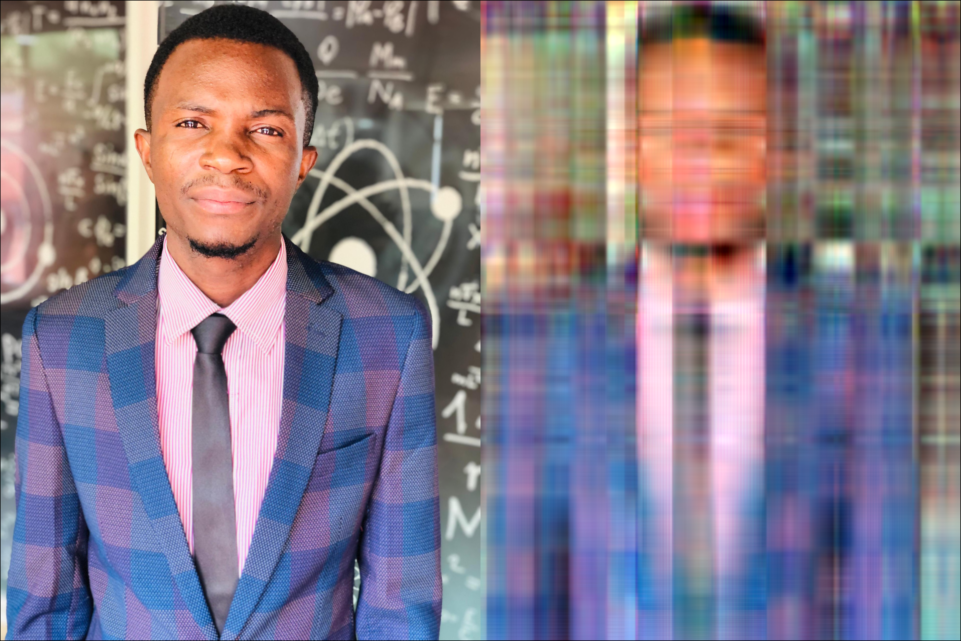

Compressed Image with Rank = 25


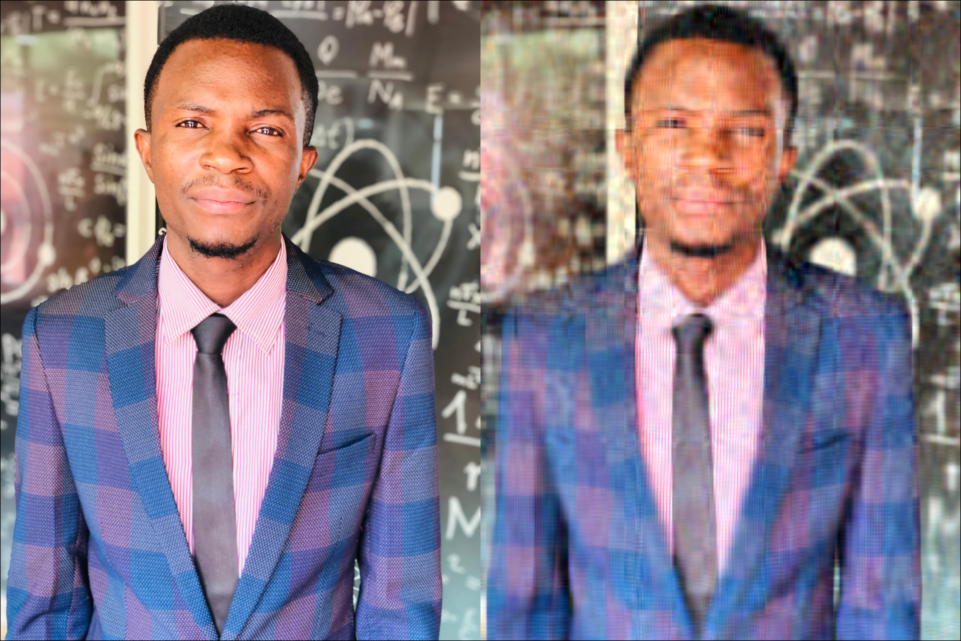

Compressed Image with Rank = 75


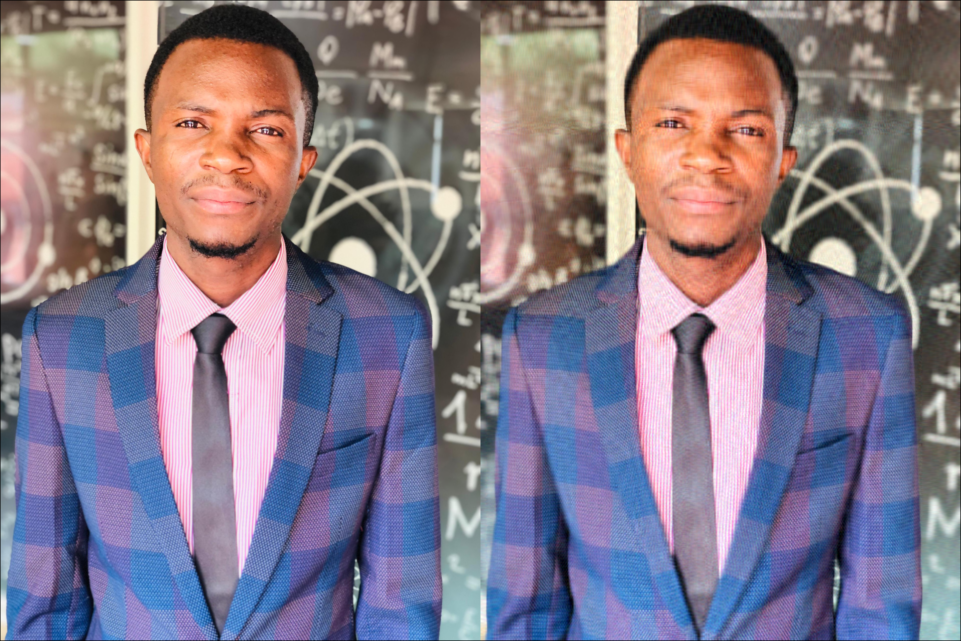

Compressed Image with Rank = 150


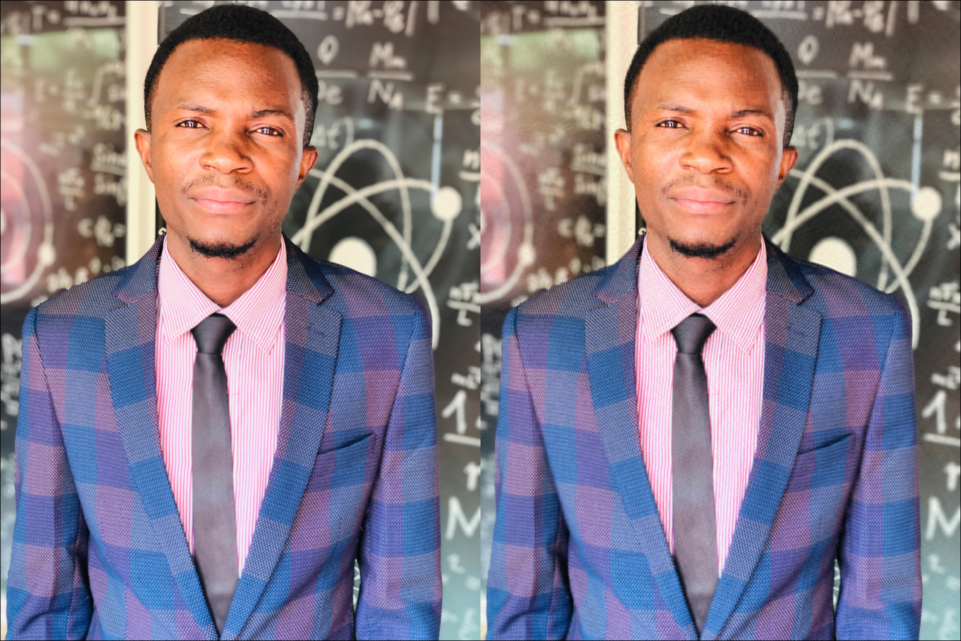

Compressed Image with Rank = 200


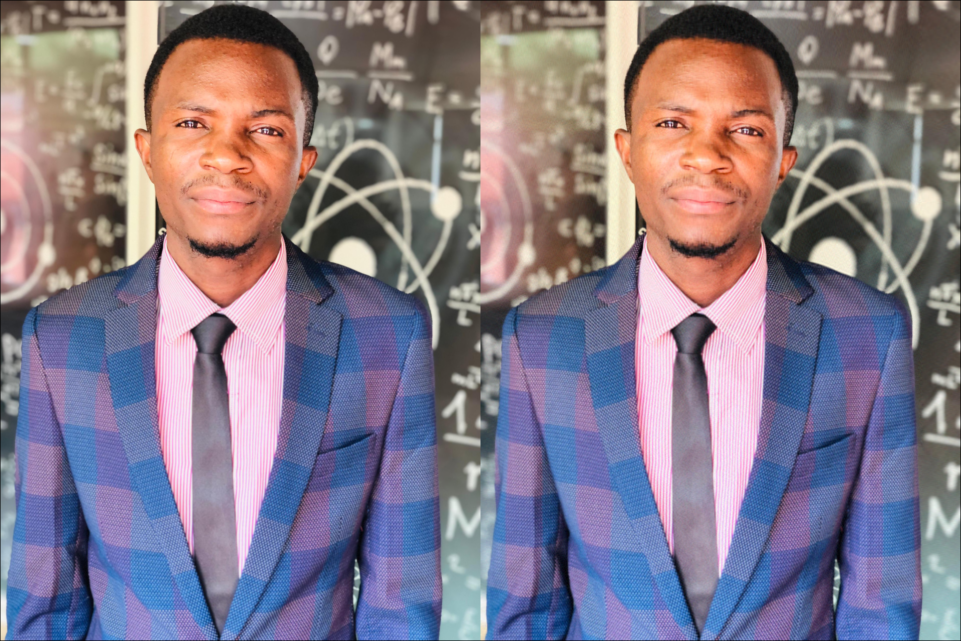

In [7]:
# Function to apply SVD and compress each channel
function compress_channel(channel, k)
    U, S, V = svd(channel)
    s_k = Diagonal(S[1:k])
    U_k = U[:, 1:k]
    V_k = V[:, 1:k]
    return U_k * s_k * V_k' # Returnig an estimate image matrix A
end



# Function to create a compressed RGB image for a given k
function compress_image(k)
    red_compressed = compress_channel(red_channel, k)
    green_compressed = compress_channel(green_channel, k)
    blue_compressed = compress_channel(blue_channel, k)

    # Construct the RGB image
    height, width = size(red_compressed)
    compressed_img_rgb = Array{RGB{Float32}, 2}(undef, height, width)

    for i in 1:height
        for j in 1:width
            compressed_img_rgb[i, j] = RGB(clamp01(red_compressed[i, j]), 
                                           clamp01(green_compressed[i, j]), 
                                           clamp01(blue_compressed[i, j]))
        end
    end

    return compressed_img_rgb

end

# List of values for k to test different compression levels
k_values = [5, 25, 75, 150,200]

# Display the original image and compressed images side by side for each k
for k in k_values
    println("Compressed Image with Rank = $k")
    compressed_image = compress_image(k)
    side_by_side = hcat(image_matrix, compressed_image)  # Combine original and compressed side by side
    display(side_by_side)
end

## Understanding `k` in SVD-Based Image Compression

In Singular Value Decomposition (SVD)-based image compression, the parameter `k` represents the number of singular values retained in each color channel (Red, Green, and Blue). Each singular value captures a component of the image’s structure, and the value of `k` controls how much detail from the original image is preserved in the compressed version. Here’s how different values of `k` affect image quality and compression:

## Effects of Different `k` Values on Image Quality

### 1. Low `k` Values (Small Singular Values Retained)
   - **Description**: The first few singular values represent the most prominent features or major structural details of the image.
   - **Visual Impact**: For very low `k` values (e.g., `k = 5`), the image is highly compressed, capturing only broad features like general shapes and dominant colors. This results in significant blurring and detail loss, making the image look abstract.
   - **Use Case**: Suitable when only a rough outline or basic colors are needed.

### 2. Intermediate `k` Values (Increasing Detail Retention)
   - **Description**: As `k` increases (e.g., `k = 20`, `k = 50`), more singular values are retained, capturing finer details and textures in the image.
   - **Visual Impact**: The image retains more clarity, with sharper edges and smoother color gradients, improving quality while still achieving meaningful compression.
   - **Use Case**: Ideal for situations where recognizable details are needed but high compression is still desired.

### 3. High `k` Values (Closer to Full Detail)
   - **Description**: For higher `k` values (e.g., `k = 100`, `k = 150`), nearly all details are preserved, creating an image that closely approximates the original quality.
   - **Visual Impact**: The compressed image becomes almost indistinguishable from the original, minimizing any noticeable loss of detail. However, the compression ratio decreases.
   - **Use Case**: Best for applications where high fidelity is required, but significant compression is not necessary.

## Practical Recommendations for Choosing `k`
- **Low `k` Values** (e.g., `k = 5`–`20`): Provides extreme compression with a heavily abstracted version of the image.
- **Moderate `k` Values** (e.g., `k = 50`–`100`): Balances image quality and compression, retaining sufficient detail for most practical purposes.
- **High `k` Values** (near full rank): Achieves high-quality compression but with minimal data savings.

**In practice, selecting `k` depends on the acceptable level of detail loss and storage limitations. Experimenting with different `k` values provides a way to visually assess the trade-off between image quality and compression level.**


Original matrixImage reconstructed with last 200 singular values:


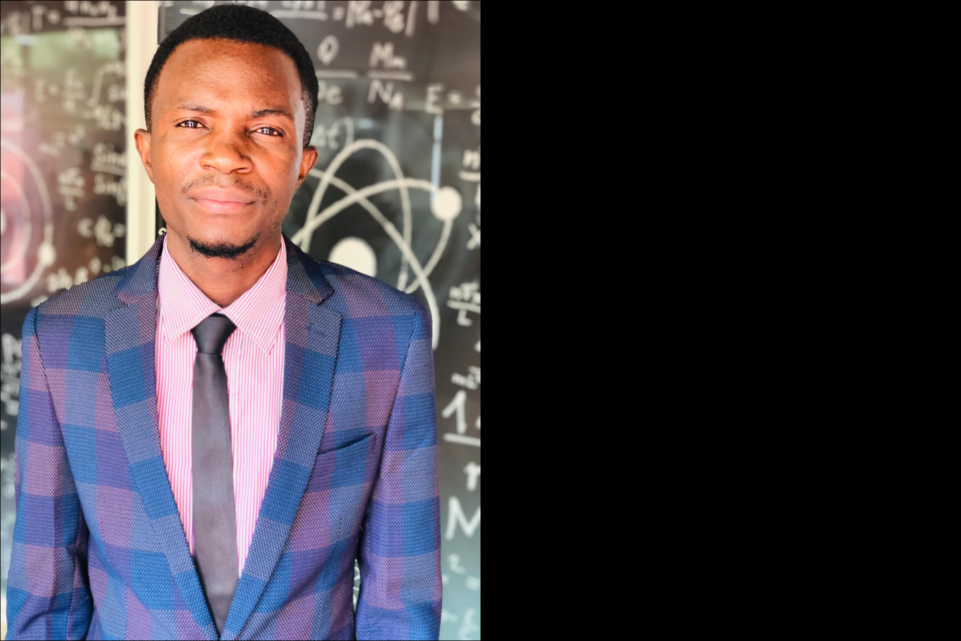

Image reconstructed with last 1000 singular values:


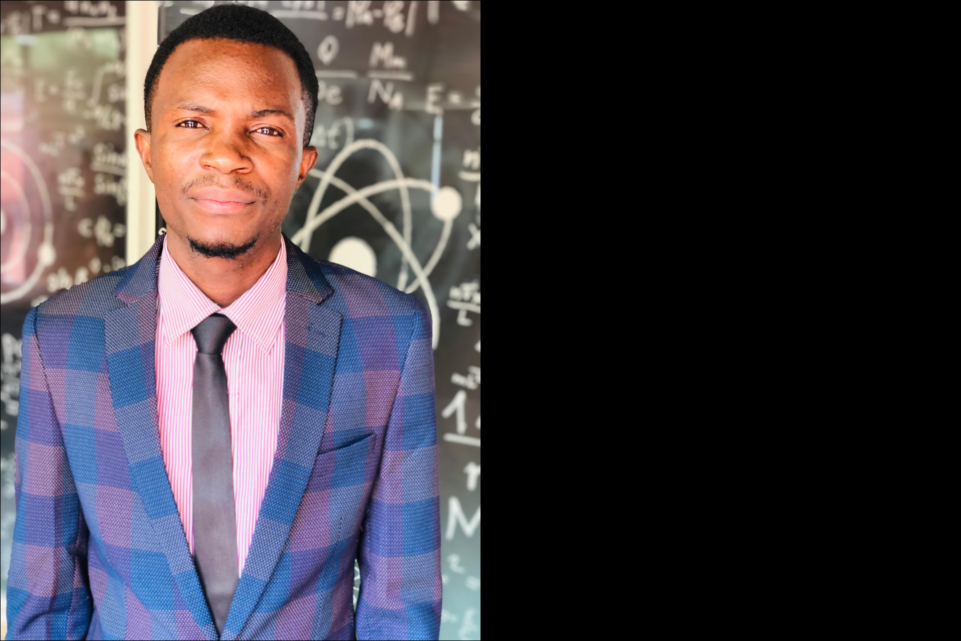

Image reconstructed with last 1900 singular values:


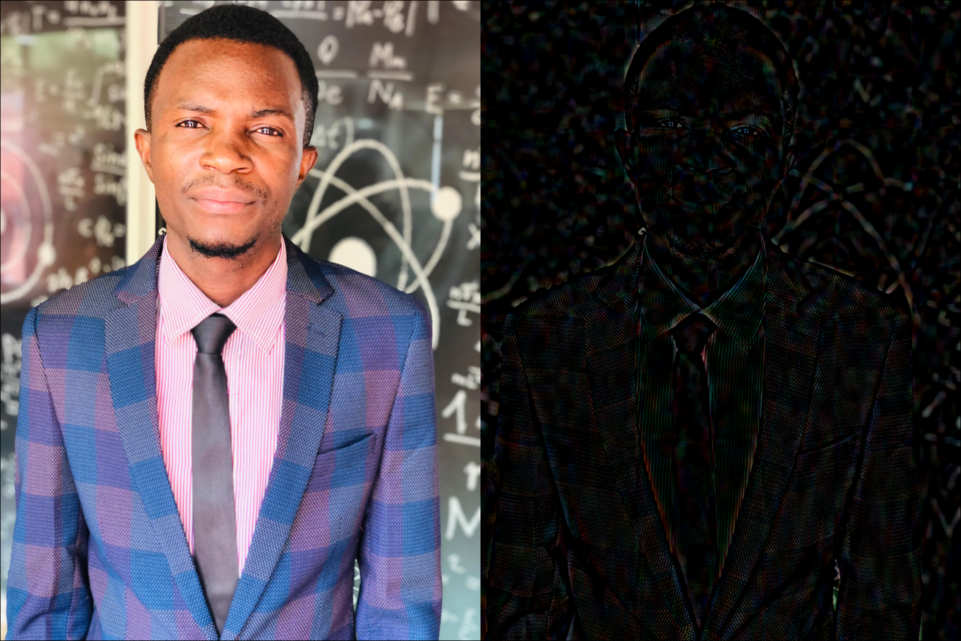

Image reconstructed with last 1917 singular values:


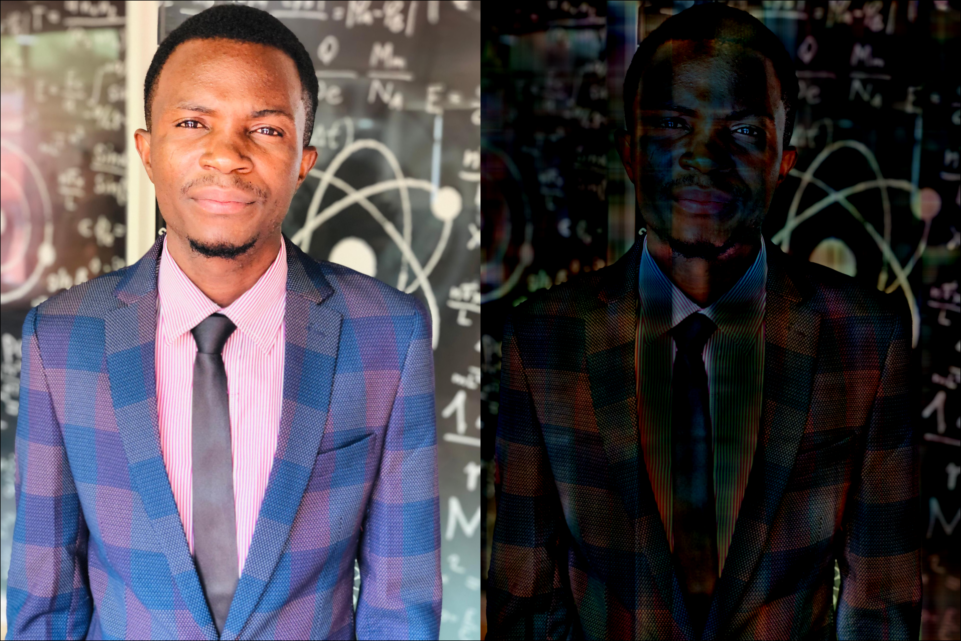

In [8]:
using Images, ImageIO, LinearAlgebra, ImageMagick


# Function to apply SVD and return U, S, V matrices
function svd_components(channel)
    return svd(channel)
end

# Function to create a compressed RGB image for a given U, S, V, and k
function compress_image(U, S, V, k)
    s_k = Diagonal(S[end-k+1:end])  # Use the last k singular values
    U_k = U[:, end-k+1:end]          # Take the last k columns of U
    V_k = V[:, end-k+1:end]          # Take the last k columns of V
    return U_k * s_k * V_k'          # Reconstruct the image using the last k components
end

#  Apply SVD to each channel
U_red, s_red, V_red = svd_components(red_channel)
U_green, s_green, V_green = svd_components(green_channel)
U_blue, s_blue, V_blue = svd_components(blue_channel)

# Analyzing contributions of last k singular values

k_last_values = [200, 1000, 1900, 1917] 

print("Original matrix")

# For each k, display the image reconstructed with the last k singular values
for k in k_last_values
    # Ensuring k does not exceed the number of singular values
    k = min(k, length(s_red))

    # Reconstruct images using the last k singular values
    red_compressed_last = compress_image(U_red, s_red, V_red, k)
    green_compressed_last = compress_image(U_green, s_green, V_green, k)
    blue_compressed_last = compress_image(U_blue, s_blue, V_blue, k)

    # Construct the RGB image
    height, width = size(red_compressed_last)
    compressed_img_rgb_last = Array{RGB{Float32}, 2}(undef, height, width)

    for i in 1:height
        for j in 1:width
            compressed_img_rgb_last[i, j] = RGB(clamp01(red_compressed_last[i, j]), 
                                               clamp01(green_compressed_last[i, j]), 
                                               clamp01(blue_compressed_last[i, j]))
        end
    end

    # Display the reconstructed image using the last k singular values
    println("Image reconstructed with last ", k, " singular values:")
    display(hcat(image_matrix,compressed_img_rgb_last))
end


# Starting from the Last Singular Values

### 1. Understanding Singular Values
- In Singular Value Decomposition (SVD), singular values are sorted in descending order, where the first singular values capture the most significant features and structural information of the image.
- As you move towards the last singular values, they typically represent finer details and less significant variations.
- Starting from the last singular values allows us to isolate and analyze the contributions of these less significant features.

### 2. Application in Image Processing
- Understanding the role of the last singular values helps in optimizing compression algorithms by determining how much data can be effectively reduced while maintaining an acceptable level of image quality.
- This analysis is crucial for applications where bandwidth or storage is limited but visual fidelity remains important.
---

## Cumulative Singular Values Plot

- The cumulative singular values plot visualizes the cumulative sum of the singular values, allowing us to assess how much of the total information or variance is captured as we include more singular values.


- This plot is particularly useful for understanding the contribution of each singular value to the overall data representation.

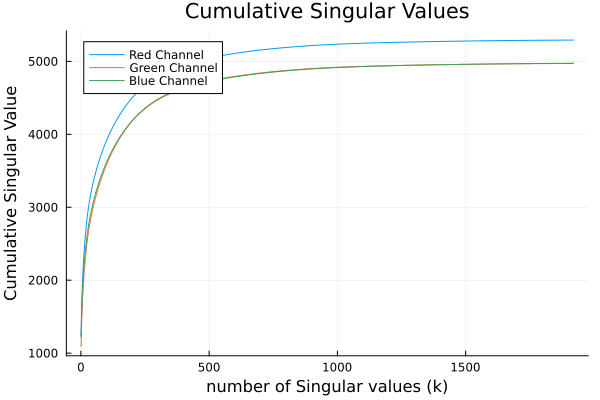

In [9]:
using Images, ImageIO, LinearAlgebra, Plots

# Function to apply SVD and return singular values
function singular_values(channel)
    U, S, V = svd(channel)
    return S  # Returns the singular values directly
end

# Apply SVD to each channel
s_red = singular_values(red_channel)
s_green = singular_values(green_channel)
s_blue = singular_values(blue_channel)

# SCalculate cumulative singular values
cumulative_singular_red = cumsum(s_red)
cumulative_singular_green = cumsum(s_green)
cumulative_singular_blue = cumsum(s_blue)

# Plot the cumulative singular values
plot(1:length(s_red), cumulative_singular_red, label="Red Channel", xlabel="number of Singular values (k)", ylabel="Cumulative Singular Value", title="Cumulative Singular Values", legend=:topleft)
plot!(1:length(s_green), cumulative_singular_green, label="Green Channel")
plot!(1:length(s_blue), cumulative_singular_blue, label="Blue Channel")



---

$$   $$


$$   $$






















## Singular Value Spectrum:


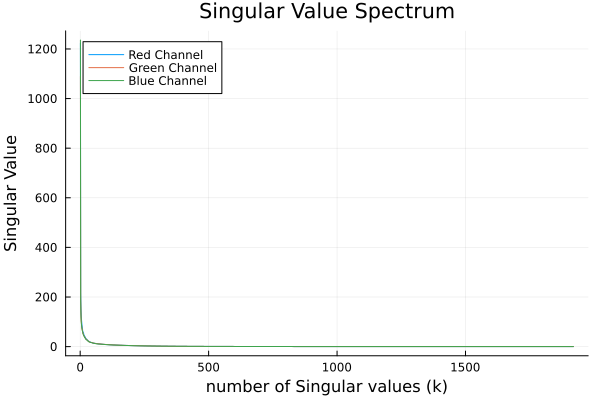

In [10]:
# Plot singular values

plot(1:length(s_red), s_red, label="Red Channel", xlabel="number of Singular values (k)", ylabel="Singular Value", title="Singular Value Spectrum", legend=:topleft)
plot!(1:length(s_green), s_green, label="Green Channel")
plot!(1:length(s_blue), s_blue, label="Blue Channel")


## Interpretation of the Singular Value Spectrum

- **Rapid Drop-Off**: The plot shows a sharp decline in singular values. This indicates that a few singular values capture the majority of the information in the image.



- This is crucial for tasks such as image compression, as it allows us to retain only the most significant singular values for effective data representation.



- **Long Tail**: The presence of singular values that decrease gradually suggests that while they may contribute some information, their impact on the overall data representation is minimal. 



- Keeping these smaller singular values in the reconstruction process may not yield significant improvements in image quality, yet they can increase computational load and storage requirements.




- **Knee Point**: The plot reveals a "knee" or "elbow" point where the singular values start to level off. This point indicates the optimal number of singular values to retain for approximating the data effectively. Choosing \( k \) near this knee point can help balance quality and efficiency.



### Key take aways :

- The majority of the data's variance can often be captured by a small number of singular values.


- Truncating singular values can lead to efficient image compression without substantial loss of quality.


- The singular value spectrum helps identify the effective rank of the matrix, which informs the best estimate of the image matrix for various applications.

